<h1>Table of Contents<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"><li><span><a href="#Plotting-the-animation-of-the-Gradient-Descent-of-a-Ridge-regression" data-toc-modified-id="Plotting-the-animation-of-the-Gradient-Descent-of-a-Ridge-regression-1"><span class="toc-item-num">1&nbsp;&nbsp;</span>Plotting the animation of the Gradient Descent of a Ridge regression</a></span><ul class="toc-item"><li><span><a href="#Ridge-regression" data-toc-modified-id="Ridge-regression-1.1"><span class="toc-item-num">1.1&nbsp;&nbsp;</span>Ridge regression</a></span></li><li><span><a href="#Gradient-descent-(vectorized)" data-toc-modified-id="Gradient-descent-(vectorized)-1.2"><span class="toc-item-num">1.2&nbsp;&nbsp;</span>Gradient descent (vectorized)</a></span></li><li><span><a href="#Closed-form-solution" data-toc-modified-id="Closed-form-solution-1.3"><span class="toc-item-num">1.3&nbsp;&nbsp;</span>Closed form solution</a></span></li><li><span><a href="#Vectorized-implementation-of-cost-function,-gradient-descent-and-closed-form-solution" data-toc-modified-id="Vectorized-implementation-of-cost-function,-gradient-descent-and-closed-form-solution-1.4"><span class="toc-item-num">1.4&nbsp;&nbsp;</span>Vectorized implementation of cost function, gradient descent and closed form solution</a></span></li><li><span><a href="#The-data" data-toc-modified-id="The-data-1.5"><span class="toc-item-num">1.5&nbsp;&nbsp;</span>The data</a></span></li><li><span><a href="#Generating-the-data-for-the-contour-and-surface-plots" data-toc-modified-id="Generating-the-data-for-the-contour-and-surface-plots-1.6"><span class="toc-item-num">1.6&nbsp;&nbsp;</span>Generating the data for the contour and surface plots</a></span></li></ul></li><li><span><a href="#Animation-of-the-contour-plot-with-gradient-descent" data-toc-modified-id="Animation-of-the-contour-plot-with-gradient-descent-2"><span class="toc-item-num">2&nbsp;&nbsp;</span>Animation of the contour plot with gradient descent</a></span></li><li><span><a href="#Animation-of-the-surface-plot-with-gradient-descent" data-toc-modified-id="Animation-of-the-surface-plot-with-gradient-descent-3"><span class="toc-item-num">3&nbsp;&nbsp;</span>Animation of the surface plot with gradient descent</a></span></li><li><span><a href="#Sources-and-interesting-examples" data-toc-modified-id="Sources-and-interesting-examples-4"><span class="toc-item-num">4&nbsp;&nbsp;</span>Sources and interesting examples</a></span></li></ul></div>

# Plotting the animation of the Gradient Descent of a Ridge regression

This notebook explores how to produce animations of gradient descent for contour and 3D plots. We use the particular example of Ridge regression for a polynomial regression of degree 2.

In particular, we model

$ y_i = \theta_1 x_i + \theta_2 x_i^2$ hence $X = [x, x^2]$ and $\theta = [\theta_1, \theta_2]^T$

## Ridge regression

#### Cost Function 
$ J(\theta) = \frac{1}{2m}\sum_{i=1}^m(h_\theta(x^{(i)}) - y^{(i)})^2 + \frac{\lambda}{2m}\sum_{j=1}^{n}\theta_{j}^{2}$

$ J(\theta) = \frac{1}{2m}(X\theta - y)^T(X\theta - y) + \frac{\lambda}{2m} \theta^T \theta$ (vectorized version)

Where $h_{\theta}(x) = X \theta$

#### Gradient 
$\frac{\partial J(\theta)}{\partial \theta} = \frac{1}{m}X^T(X\theta - y) + \frac{\lambda}{m} \theta $ 

## Gradient descent (vectorized)
$\theta^{(t+1)} : = \theta^{(t)} - \alpha \frac{\partial}{\partial \theta} J(\theta^{(t)}) $

 - $\alpha$ is the gradient descent **stepsize**
 - $\lambda$ is the Ridge regression hyperparameter, sometimes called the **complexity** parameter
 

## Closed form solution

$\theta = (X^TX + \lambda I)^{-1} X^T Y$

### Libraries


In [35]:
import numpy as np
import pandas as pd
from matplotlib import pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from matplotlib import animation
from IPython.display import HTML, Image


%matplotlib inline
plt.style.use('seaborn-white')

## Vectorized implementation of cost function, gradient descent and closed form solution
### Numpy only

In [19]:

def costFunctionReg(X,y,theta,lamda = 10):    
    #Initializations
    m = len(y) 
    J = 0
    
    #Computations
    h = X @ theta
    J_reg = (lamda / (2*m)) * np.sum(np.square(theta))
    J = float((1./(2*m)) * (h - y).T @ (h - y)) + J_reg;
    
    if np.isnan(J):
        return(np.inf)
    
    return(J) 


def gradient_descent_reg(X,y,theta,alpha = 0.0005,lamda = 10,num_iters=1000):
    #Initialisation of useful values 
    m = np.size(y)
    J_history = np.zeros(num_iters)
    theta_0_hist, theta_1_hist = [], [] #Used for three d plot

    for i in range(num_iters):
        #Hypothesis function
        h = np.dot(X,theta)
        
        #Calculating the grad function in vectorized form
        theta = theta - alpha * (1/m)* (  (X.T @ (h-y)) + lamda * theta )
           
        #Cost function in vectorized form       
        J_history[i] = costFunctionReg(X,y,theta,lamda)
           
        #Calculate the cost for each iteration(used to plot convergence)
        theta_0_hist.append(theta[0,0])
        theta_1_hist.append(theta[1,0])
    
    return theta ,J_history, theta_0_hist, theta_1_hist

def closed_form_reg_solution(X,y,lamda = 10): 
    m,n = X.shape
    I = np.eye((n))
    return np.linalg.inv(X.T @ X + lamda * I) @ X.T @ y

## The data
### Sine curve with uniform noise

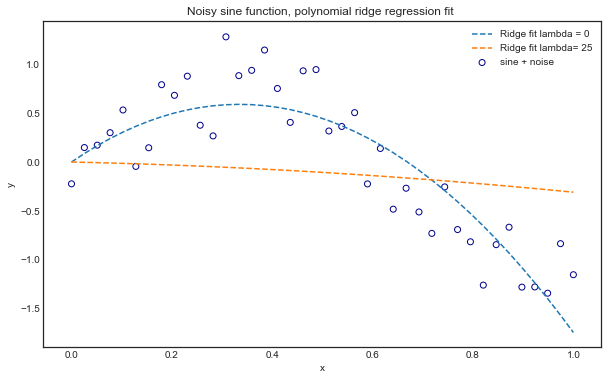

'Coefficients with lambda = 25 are: '

array([[-0.11550218],
       [-0.19306915]])

In [32]:
#Creating the dataset (as previously)
x = np.linspace(0,1,40)
noise = 1*np.random.uniform(  size = 40)
y = np.sin(x * 1.5 * np.pi ) 
y_noise = (y + noise).reshape(-1,1)
y_noise = y_noise - y_noise.mean() #Centering the dataset


#Plotting the data
plt.figure(figsize=(10,6))
plt.scatter(x,y_noise, facecolors = 'none', edgecolor = 'darkblue', label = 'sine + noise')
plt.title('Noisy sine function, polynomial ridge regression fit ')
plt.xlabel('x')
plt.ylabel('y')

#Design matrix for polynomial regression of order 2
X = np.vstack((x,x**2)).T

#Calculating closed form regression coefficients with lamda = 0 and 25
theta_calc_0 = closed_form_reg_solution(X,y_noise,lamda = 0)
theta_calc_25 = closed_form_reg_solution(X,y_noise,lamda = 25)

#Plot
plt.plot(x,X@theta_calc_0, '--', label = 'Ridge fit lambda = {}'.format(0))
plt.plot(x,X@theta_calc_25, '--', label = 'Ridge fit lambda= {}'.format(25))
plt.legend()
plt.show()

display('Coefficients with lambda = 25 are: ' ,theta_calc_25)

## Generating the data for the contour and surface plots 

In [34]:
l = 25 #Complexity hyperparameter lambda = 25

#Setup of meshgrid of theta values
T1, T2 = np.meshgrid(np.linspace(-5,5,100),np.linspace(-6,3,100))

#Computing the cost function for each theta combination
zs = np.array(  [costFunctionReg(X, y_noise.reshape(-1,1),np.array([t1,t2]).reshape(-1,1),l) 
                     for t1, t2 in zip(np.ravel(T1), np.ravel(T2)) ] )
#Reshaping the cost values    
Z = zs.reshape(T1.shape)

# Animation of the contour plot with gradient descent 

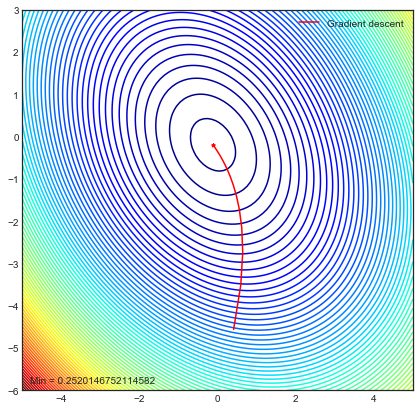

In [36]:

#Plot the contour
fig1, ax1 = plt.subplots(figsize = (7,7))
ax1.contour(T1, T2, Z, 100, cmap = 'jet')


# Create animation
line, = ax1.plot([], [], 'r', label = 'Gradient descent', lw = 1.5)
point, = ax1.plot([], [], '*', color = 'red', markersize = 4)
value_display = ax1.text(0.02, 0.02, '', transform=ax1.transAxes)

def init_1():
    line.set_data([], [])
    point.set_data([], [])
    value_display.set_text('')

    return line, point, value_display

def animate_1(i):
    # Animate line
    line.set_data(theta_0[:i], theta_1[:i])
    
    # Animate points
    point.set_data(theta_0[i], theta_1[i])

    # Animate value display
    value_display.set_text('Min = ' + str(J_history_reg[i]))

    return line, point, value_display

ax1.legend(loc = 1)

anim1 = animation.FuncAnimation(fig1, animate_1, init_func=init_1,
                               frames=len(theta_0), interval=100, 
                               repeat_delay=60, blit=True)
#plt.show()
HTML(anim1.to_jshtml())


# Animation of the surface plot with gradient descent 

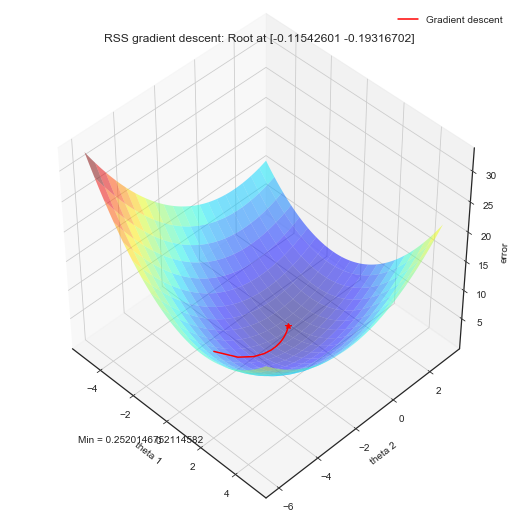

In [38]:
fig2 = plt.figure(figsize = (7,7))
ax2 = Axes3D(fig2)

#Surface plot
ax2.plot_surface(T1, T2, Z, rstride = 5, cstride = 5, cmap = 'jet', alpha=0.5)
#ax2.plot(theta_0,theta_1,J_history_reg, marker = '*', color = 'r', alpha = .4, label = 'Gradient descent')

ax2.set_xlabel('theta 1')
ax2.set_ylabel('theta 2')
ax2.set_zlabel('error')
ax2.set_title('RSS gradient descent: Root at {}'.format(theta_result_reg.ravel()))
ax2.view_init(45, -45)

# Create animation
line, = ax2.plot([], [], [], 'r-', label = 'Gradient descent', lw = 1.5)
point, = ax2.plot([], [], [], '*', color = 'red')
display_value = ax2.text(2., 2., 27.5, '', transform=ax1.transAxes)

def init_2():
    line.set_data([], [])
    line.set_3d_properties([])
    point.set_data([], [])
    point.set_3d_properties([])
    display_value.set_text('')

    return line, point, display_value

def animate_2(i):
    # Animate line
    line.set_data(theta_0[:i], theta_1[:i])
    line.set_3d_properties(J_history_reg[:i])
    
    # Animate points
    point.set_data(theta_0[i], theta_1[i])
    point.set_3d_properties(J_history_reg[i])

    # Animate display value
    display_value.set_text('Min = ' + str(J_history_reg[i]))

    return line, point, display_value

ax2.legend(loc = 1)

anim2 = animation.FuncAnimation(fig2, animate_2, init_func=init_2,
                               frames=len(theta_0), interval=120, 
                               repeat_delay=60, blit=True)

#plt.show()
HTML(anim2.to_jshtml())

# Sources and interesting examples

- [Louis Tao][2] Animations on jupyter notebooks
- [Louis Tao][1] Save animations as gifs
- [JedAi][3] Visualizing gradient descent

[1]: http://tiao.io/posts/notebooks/save-matplotlib-animations-as-gifs/
[2]: http://tiao.io/posts/notebooks/embedding-matplotlib-animations-in-jupyter-notebooks/
[3]: https://jed-ai.github.io/py1_gd_animation/